<a href="https://colab.research.google.com/github/AgungA1/OCR/blob/main/OCR_Object_Recognition.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

**Kelompok 5 (DATASET KELOMPOK 7):**

* Agung Malik Al Qindy / 2141720114

* Billie Faiqul Izzat / 214172020051

* Shovinas Hanun / 2141720252

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import cv2
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from google.colab.patches import cv2_imshow
import tensorflow as tf
import imutils
from imutils.contours import sort_contours

In [ ]:
path_rohmatul = [
    '/content/drive/MyDrive/Colab Notebooks/Computer Vision/Tugas Akhir OCR/Kelompok 7/3A_2141710062_1 - M. ROHMATUL MAULUDI.jpg',
    '/content/drive/MyDrive/Colab Notebooks/Computer Vision/Tugas Akhir OCR/Kelompok 7/3A_2141710062_2 - M. ROHMATUL MAULUDI.jpg',
    '/content/drive/MyDrive/Colab Notebooks/Computer Vision/Tugas Akhir OCR/Kelompok 7/3A_2141710062_3 - M. ROHMATUL MAULUDI.jpg',
    '/content/drive/MyDrive/Colab Notebooks/Computer Vision/Tugas Akhir OCR/Kelompok 7/3A_2141710062_4 - M. ROHMATUL MAULUDI.jpg',
    '/content/drive/MyDrive/Colab Notebooks/Computer Vision/Tugas Akhir OCR/Kelompok 7/3A_2141710062_5 - M. ROHMATUL MAULUDI.jpg',
]
path_dandy = [
    '/content/drive/MyDrive/Colab Notebooks/Computer Vision/Tugas Akhir OCR/Kelompok 7/3A_2141720002_1 - DANDY WAHYU SYAHPUTRA.jpg',
    '/content/drive/MyDrive/Colab Notebooks/Computer Vision/Tugas Akhir OCR/Kelompok 7/3A_2141720002_2 - DANDY WAHYU SYAHPUTRA.jpg',
    '/content/drive/MyDrive/Colab Notebooks/Computer Vision/Tugas Akhir OCR/Kelompok 7/3A_2141720002_3 - DANDY WAHYU SYAHPUTRA.jpg',
    '/content/drive/MyDrive/Colab Notebooks/Computer Vision/Tugas Akhir OCR/Kelompok 7/3A_2141720002_4 - DANDY WAHYU SYAHPUTRA.jpg',
    '/content/drive/MyDrive/Colab Notebooks/Computer Vision/Tugas Akhir OCR/Kelompok 7/3A_2141720002_5 - DANDY WAHYU SYAHPUTRA.jpg',
]
path_aditya = [
    '/content/drive/MyDrive/Colab Notebooks/Computer Vision/Tugas Akhir OCR/Kelompok 7/3A_2041720231_1 - ADITYA KUNCARA.jpeg',
    '/content/drive/MyDrive/Colab Notebooks/Computer Vision/Tugas Akhir OCR/Kelompok 7/3A_2041720231_2 - ADITYA KUNCARA.jpeg',
    '/content/drive/MyDrive/Colab Notebooks/Computer Vision/Tugas Akhir OCR/Kelompok 7/3A_2041720231_3 - ADITYA KUNCARA.jpeg',
    '/content/drive/MyDrive/Colab Notebooks/Computer Vision/Tugas Akhir OCR/Kelompok 7/3A_2041720231_4 - ADITYA KUNCARA.jpeg',
    '/content/drive/MyDrive/Colab Notebooks/Computer Vision/Tugas Akhir OCR/Kelompok 7/3A_2041720231_5 - ADITYA KUNCARA.jpeg',
]

In [ ]:
def display(img):
  img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
  img_resize = cv2.resize(img, dsize=None, fx=0.15, fy=0.15)
  plt.imshow(img_resize)
  plt.show()

def display2(img):
  img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
  img_resize = cv2.resize(img, dsize=None, fx=0.25, fy=0.25)
  plt.imshow(img_resize)
  plt.show()

In [ ]:
def preprocess_image(img):
    inverted = cv2.bitwise_not(img)
    blurred = cv2.GaussianBlur(inverted, (5, 5), 0)

    kernel_erosion = np.ones((5, 5), np.uint8)
    eroded = cv2.erode(blurred, kernel_erosion, iterations=10)

    kernel_dilation = np.ones((5, 5), np.uint8)
    dilated = cv2.dilate(eroded, kernel_dilation, iterations=10)

    edges = cv2.Canny(dilated, 30, 30)

    kernel_dilation2 = np.ones((3, 3), np.uint8)
    dilation2 = cv2.dilate(edges, kernel_dilation2, iterations=2)

    return dilation2

def find_contours(image):
  contours, _ = cv2.findContours(image, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

  max_area = 0
  x,y,w,h = 0,0,0,0
  for cnt in contours:
      area = cv2.contourArea(cnt)
      if area > max_area:
          max_area = area
          x,y,w,h = cv2.boundingRect(cnt)

  return x, y, w, h

In [ ]:
labels = '0123456789ABCDEFGHIJKLMNOPQRSTUVWYZ'
labels = [l for l in labels]
width, height = 100, 100

model = tf.keras.models.load_model('/content/drive/MyDrive/Colab Notebooks/Computer Vision/Tugas Akhir OCR/charv2.h5')

In [ ]:
def predict(image, inverted_image, width, height, model, labels):
  copy = inverted_image.copy()
  img = image.copy()
  contours, _ = cv2.findContours(inverted_image, cv2.RETR_TREE, cv2.CHAIN_APPROX_NONE)

  for contour in contours:
    x, y, w, h = cv2.boundingRect(contour)
    tmp = copy[y:y+h, x:x+w]
    tmp = cv2.resize(tmp, (width, height))
    tmp = cv2.cvtColor(tmp, cv2.COLOR_GRAY2BGR)
    tmp = np.array(tmp).reshape(-1, width, height, 3)
    tmp = tmp / 255

    if(w>3 and h>10):
      prediction = model.predict(tmp)
      cv2.rectangle(img, (x, y), (x+w, y+h), (0,255,0), 2)
      cv2.putText(img, (labels[np.argmax(prediction[0])]), (x, y + 50), fontFace=cv2.FONT_HERSHEY_SIMPLEX , fontScale=1, color=(255,255,255), thickness=3)

  return img

# KTM Rohmatul

In [ ]:
ktm_rohmatul = []
ktm_rohmatul_preps = []

## Preprocessing

- KTM 1

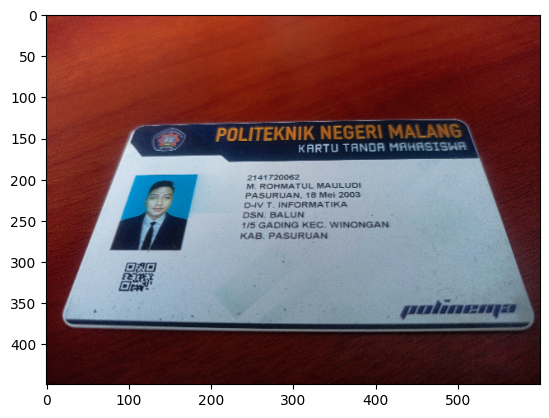

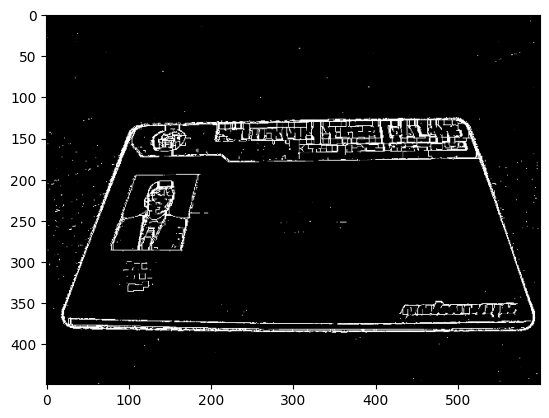

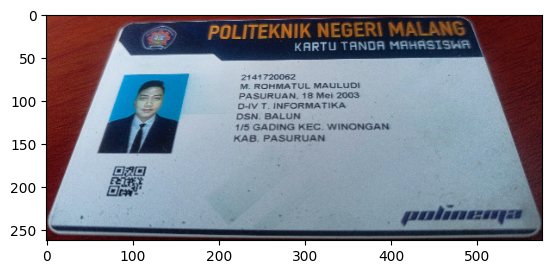

In [ ]:
ktm1 = cv2.imread(path_rohmatul[0])
ktm1_preprocess = preprocess_image(ktm1)
x, y, w, h = find_contours(ktm1_preprocess)
ktm_crop1 = ktm1[y:y+h,x:x+w]
ktm_rohmatul.append(ktm_crop1)

display(ktm1)
display(ktm1_preprocess)
display(ktm_crop1)

- KTM 2

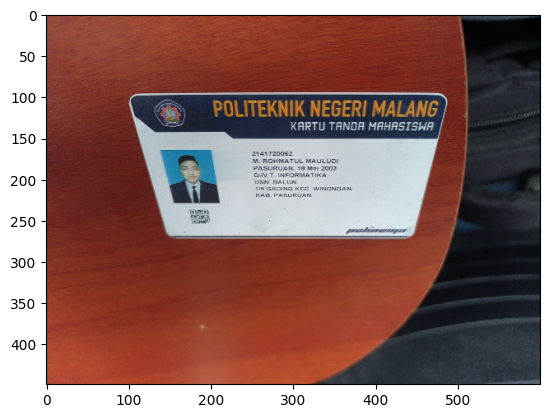

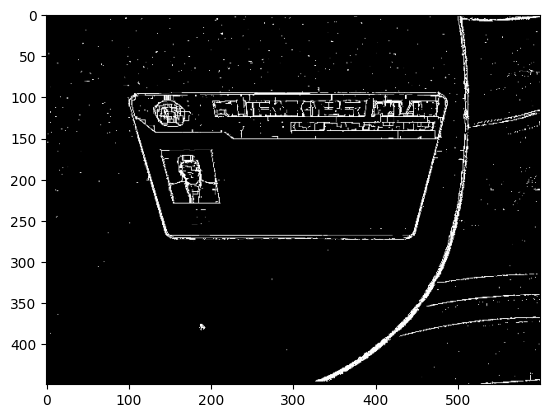

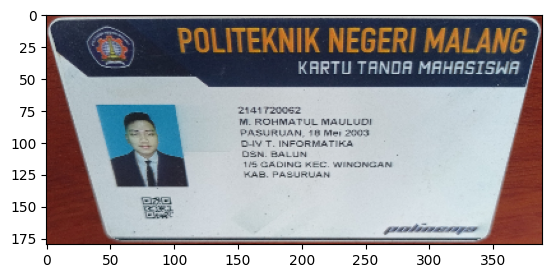

In [ ]:
ktm2 = cv2.imread(path_rohmatul[1])
ktm2_preprocess = preprocess_image(ktm2)
x, y, w, h = find_contours(ktm2_preprocess)
ktm_crop2 = ktm2[y:y+h,x:x+w]
ktm_rohmatul.append(ktm_crop2)

display(ktm2)
display(ktm2_preprocess)
display(ktm_crop2)

- KTM 3

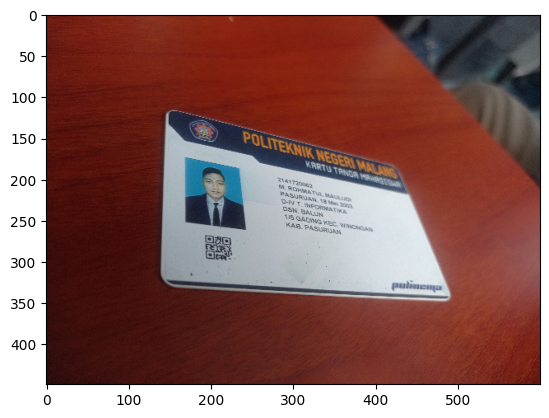

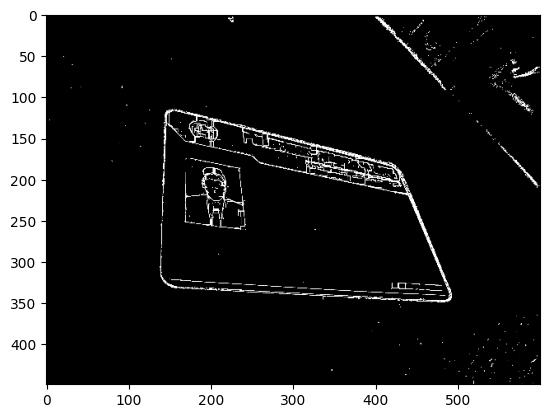

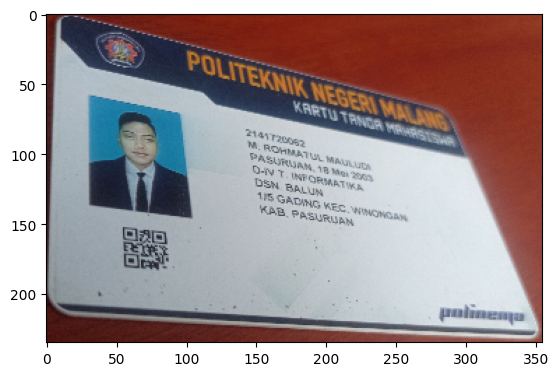

In [ ]:
ktm3 = cv2.imread(path_rohmatul[2])
ktm3_preprocess = preprocess_image(ktm3)
x, y, w, h = find_contours(ktm3_preprocess)
ktm_crop3 = ktm3[y:y+h,x:x+w]
ktm_rohmatul.append(ktm_crop3)

display(ktm3)
display(ktm3_preprocess)
display(ktm_crop3)

- KTM 4

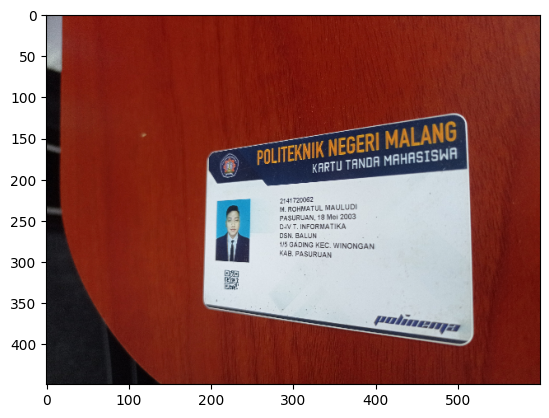

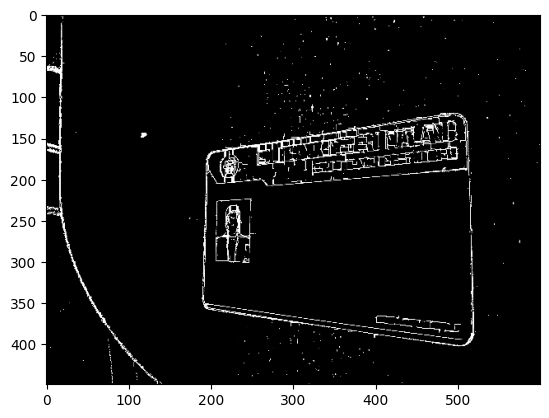

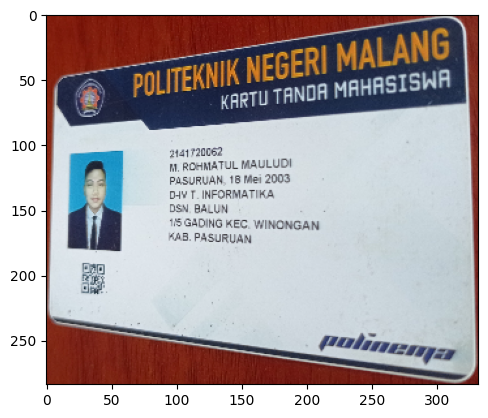

In [ ]:
ktm4 = cv2.imread(path_rohmatul[3])
ktm4_preprocess = preprocess_image(ktm4)
x, y, w, h = find_contours(ktm4_preprocess)
ktm_crop4 = ktm4[y:y+h,x:x+w]
ktm_rohmatul.append(ktm_crop4)

display(ktm4)
display(ktm4_preprocess)
display(ktm_crop4)

- KTM 5

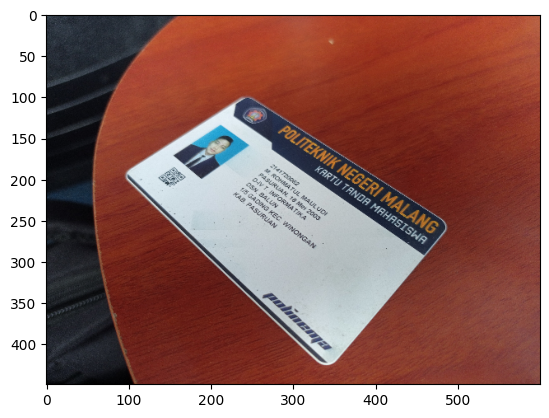

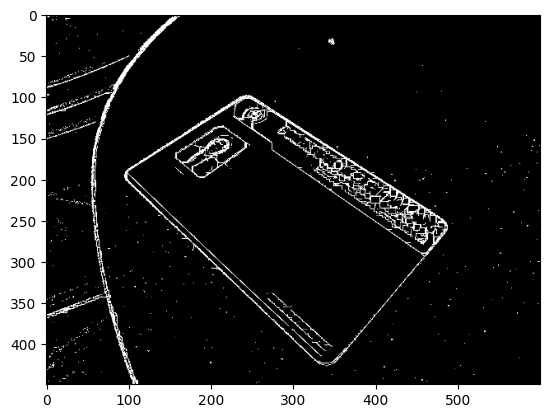

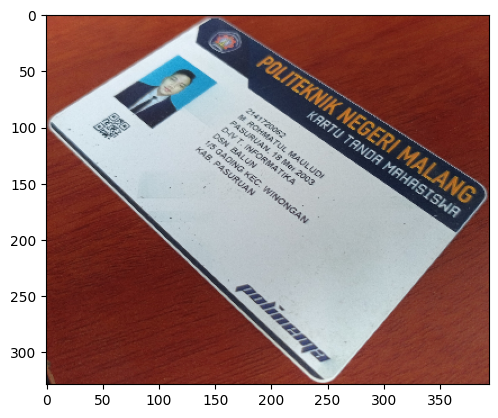

In [ ]:
ktm5 = cv2.imread(path_rohmatul[4])
ktm5_preprocess = preprocess_image(ktm5)
x, y, w, h = find_contours(ktm5_preprocess)
ktm_crop5 = ktm5[y:y+h,x:x+w]
ktm_rohmatul.append(ktm_crop5)

display(ktm5)
display(ktm5_preprocess)
display(ktm_crop5)

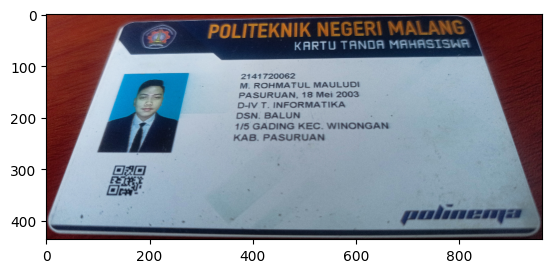

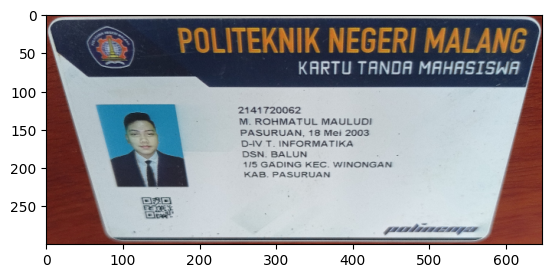

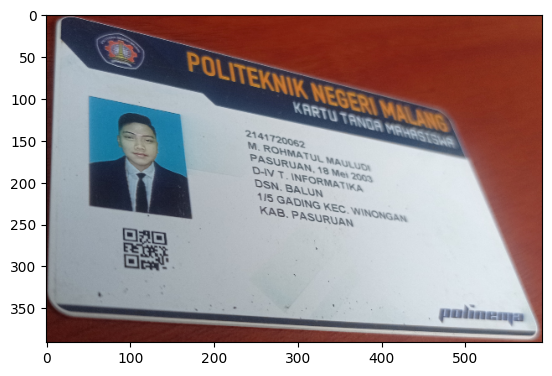

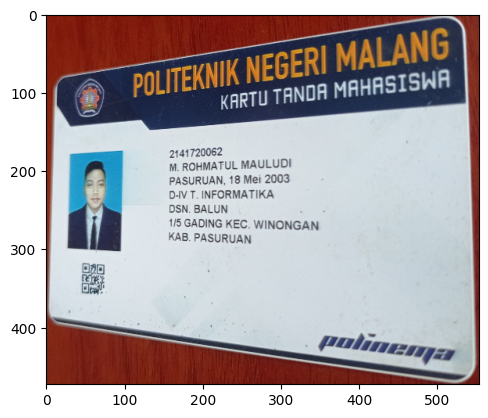

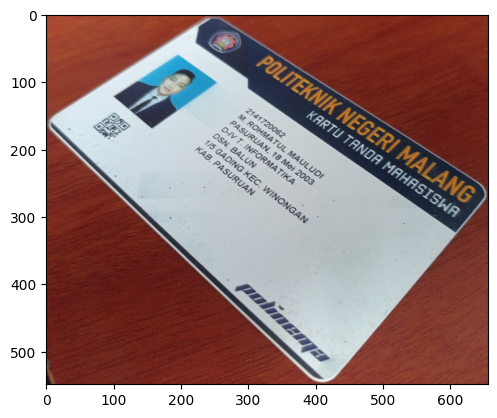

In [ ]:
# checking ktm_rohmatul[] values:
count = 0
for img in ktm_rohmatul:
  display2(img)
  count += 1

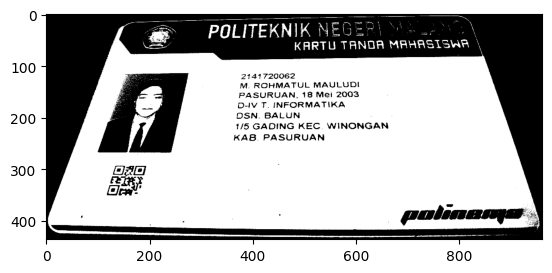

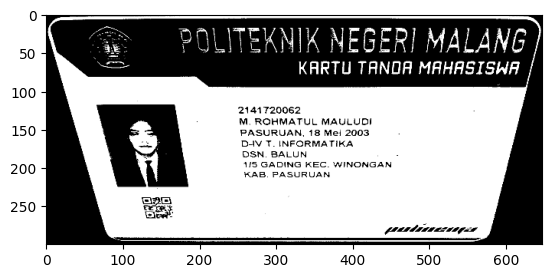

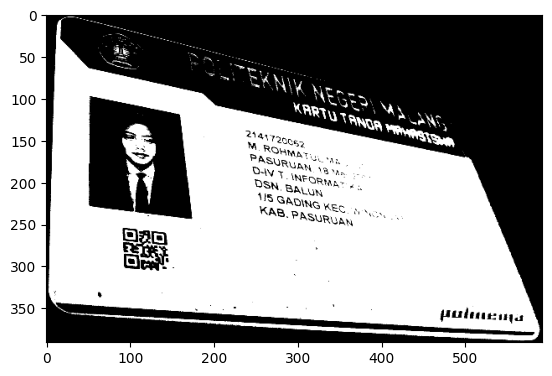

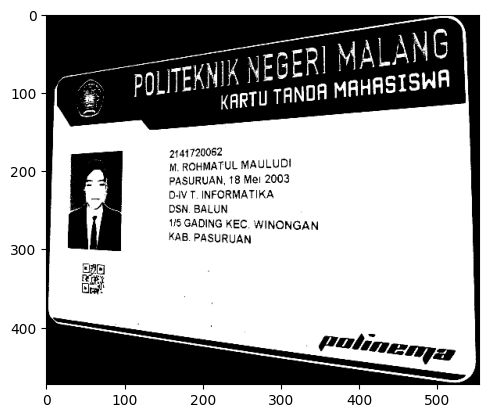

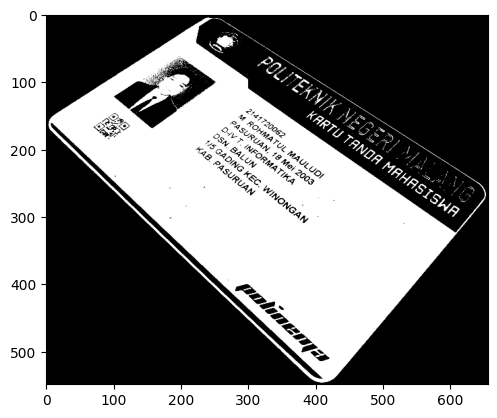

In [ ]:
# convert ktm_rohmatul[] to gray and thresh
count = 0
for img in ktm_rohmatul:
  gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
  _, thresh = cv2.threshold(gray, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
  ktm_rohmatul_preps.append(thresh)
  count += 1

# checking ktm_rohmatul_preps[] values:
count = 0
for img in ktm_rohmatul_preps:
  display2(img)
  count += 1

## Char Detection

- KTM 1

In [ ]:
ktm1_predict = predict(ktm_rohmatul[0], ktm_rohmatul_preps[0], width, height, model, labels)
cv2_imshow(ktm1_predict)

- KTM 2

1/1 [==============================] - 0s 67ms/step


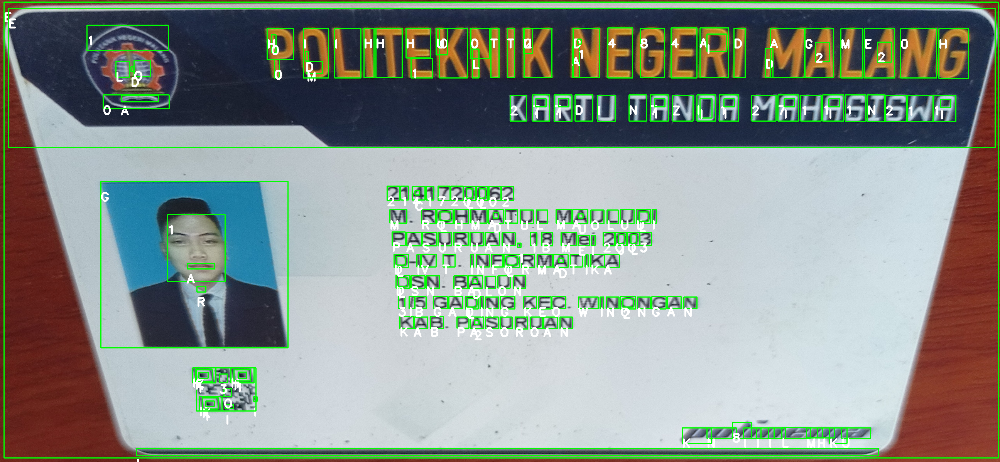

In [ ]:
ktm2_predict = predict(ktm_rohmatul[1], ktm_rohmatul_preps[1], width, height, model, labels)
cv2_imshow(ktm2_predict)

- KTM 3

1/1 [==============================] - 0s 18ms/step


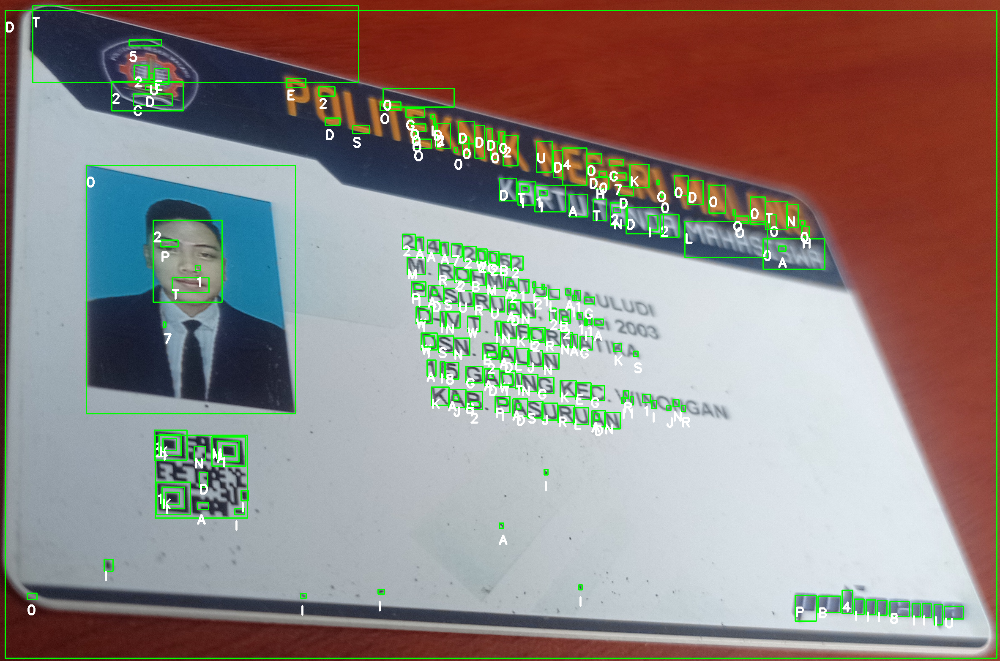

In [ ]:
ktm3_predict = predict(ktm_rohmatul[2], ktm_rohmatul_preps[2], width, height, model, labels)
cv2_imshow(ktm3_predict)

- KTM 4

1/1 [==============================] - 0s 42ms/step


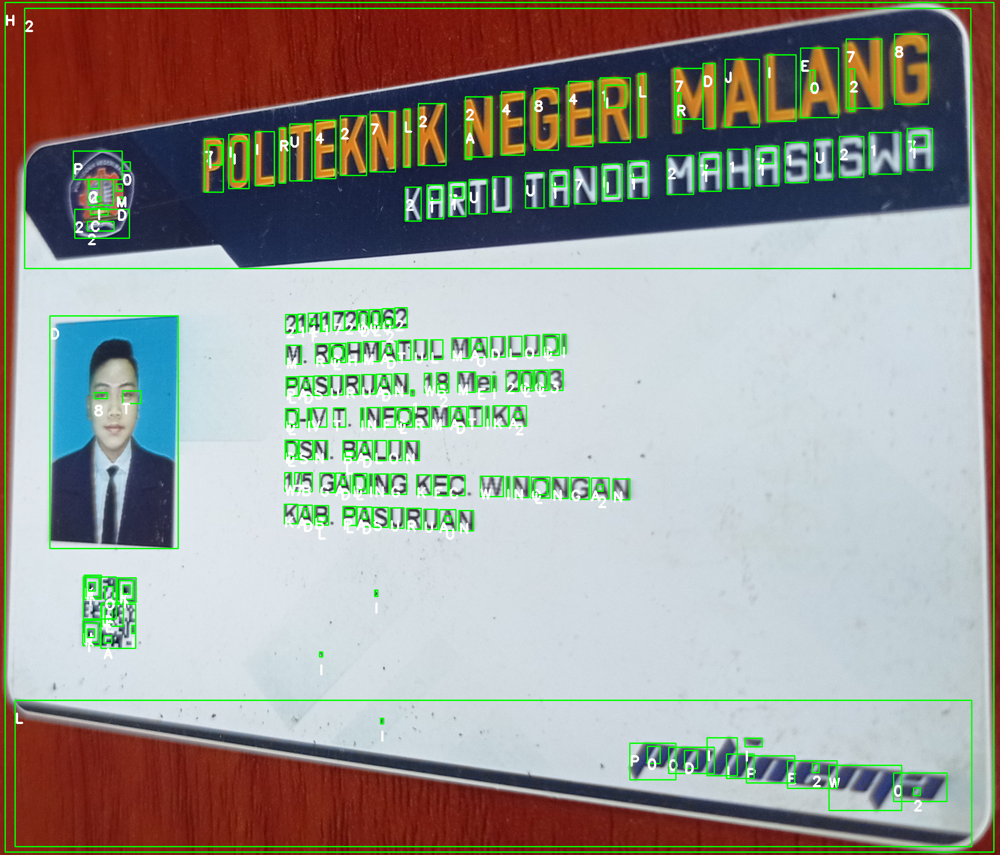

In [ ]:
ktm4_predict = predict(ktm_rohmatul[3], ktm_rohmatul_preps[3], width, height, model, labels)
cv2_imshow(ktm4_predict)

- KTM 5

In [ ]:
ktm5_predict = predict(ktm_rohmatul[4], ktm_rohmatul_preps[4], width, height, model, labels)
cv2_imshow(ktm5_predict)

# KTM Aditya

In [ ]:
ktm_aditya = []
ktm_aditya_inversed = []

## Preprocessing

- KTM 1

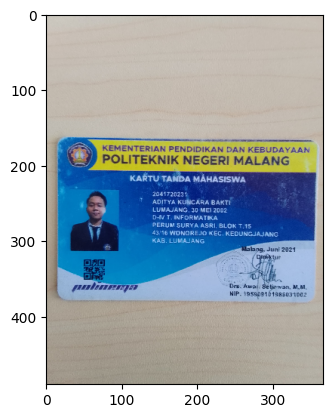

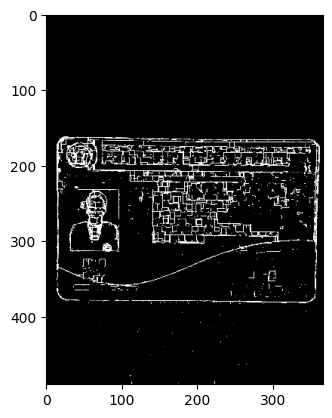

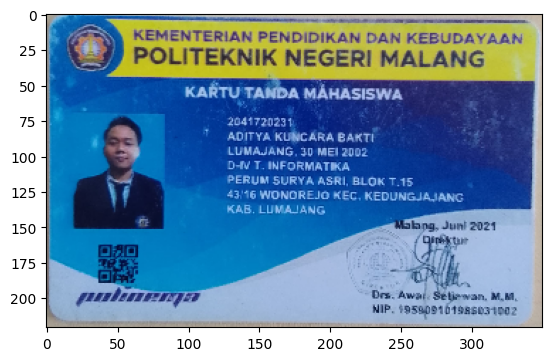

In [ ]:
ktm6 = cv2.imread(path_aditya[0])
ktm6_preprocess = preprocess_image(ktm6)
x, y, w, h = find_contours(ktm6_preprocess)
ktm_crop6 = ktm6[y:y+h,x:x+w]
ktm_aditya.append(ktm_crop6)

display(ktm6)
display(ktm6_preprocess)
display(ktm_crop6)

- KTM 2

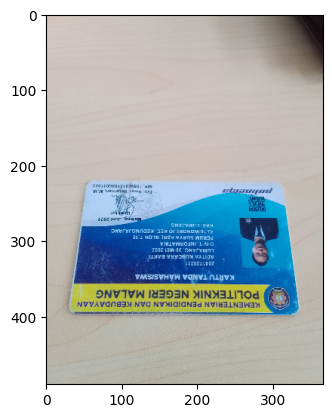

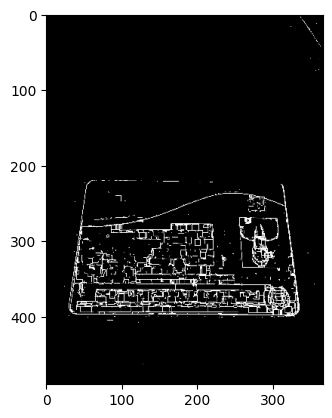

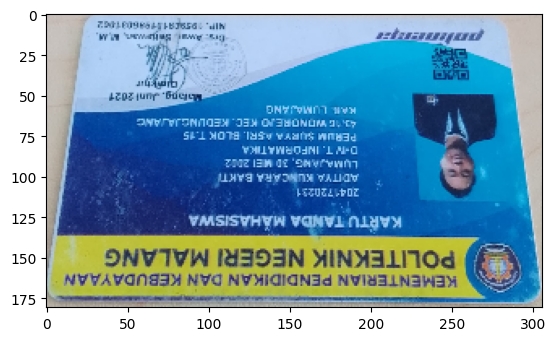

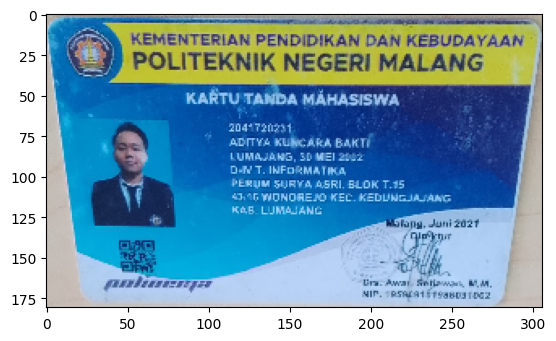

In [ ]:
ktm7 = cv2.imread(path_aditya[1])
ktm7_preprocess = preprocess_image(ktm7)
x, y, w, h = find_contours(ktm7_preprocess)
ktm_crop7 = ktm7[y:y+h,x:x+w]
ktm_rotated7 = cv2.rotate(ktm_crop7,cv2.ROTATE_180)
ktm_aditya.append(ktm_rotated7)

display(ktm7)
display(ktm7_preprocess)
display(ktm_crop7)
display(ktm_rotated7)

- KTM 3

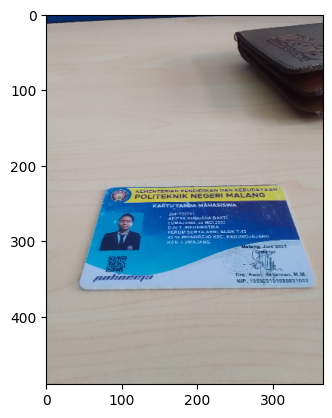

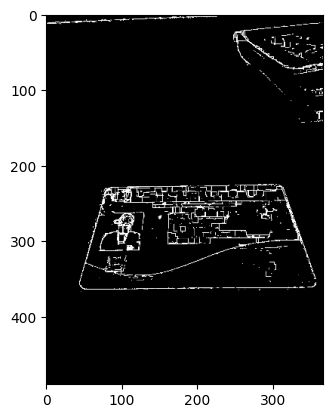

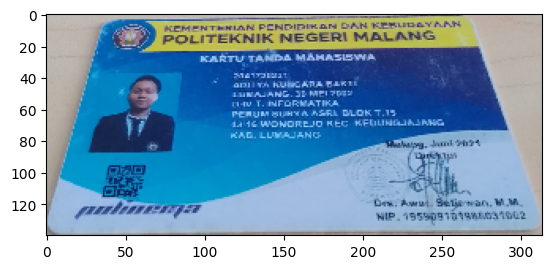

In [ ]:
ktm8 = cv2.imread(path_aditya[2])
ktm8_preprocess = preprocess_image(ktm8)
x, y, w, h = find_contours(ktm8_preprocess)
ktm_crop8 = ktm8[y:y+h,x:x+w]
ktm_aditya.append(ktm_crop8)

display(ktm8)
display(ktm8_preprocess)
display(ktm_crop8)

- KTM 4

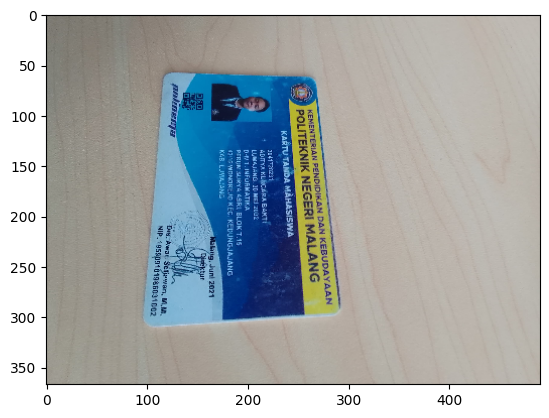

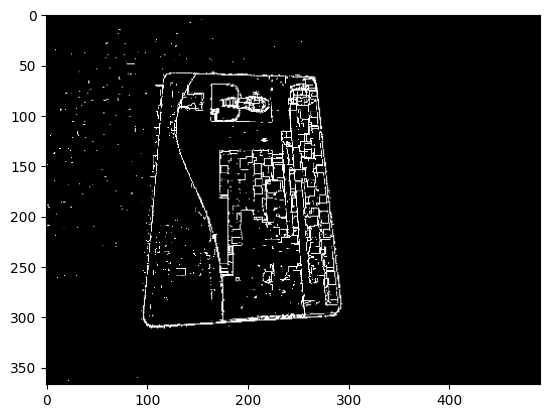

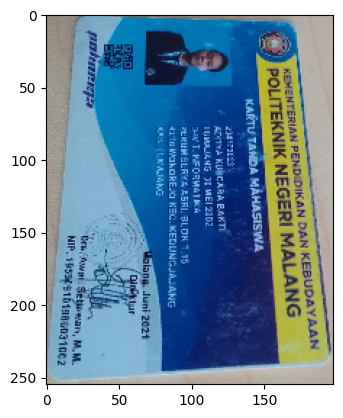

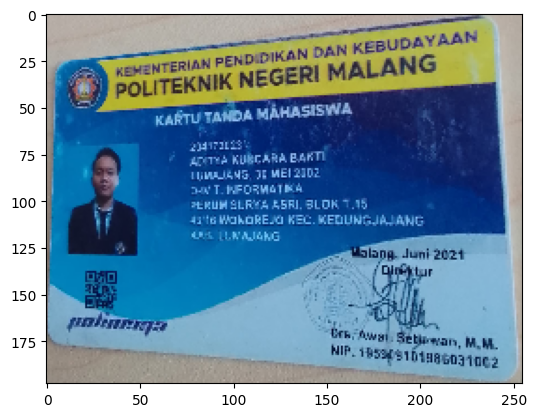

In [ ]:
ktm9 = cv2.imread(path_aditya[3])
ktm9_preprocess = preprocess_image(ktm9)
x, y, w, h = find_contours(ktm9_preprocess)
ktm_crop9 = ktm9[y:y+h,x:x+w]
ktm_rotated9 = cv2.rotate(ktm_crop9,cv2.ROTATE_90_COUNTERCLOCKWISE)
ktm_aditya.append(ktm_rotated9)

display(ktm9)
display(ktm9_preprocess)
display(ktm_crop9)
display(ktm_rotated9)

- KTM 5

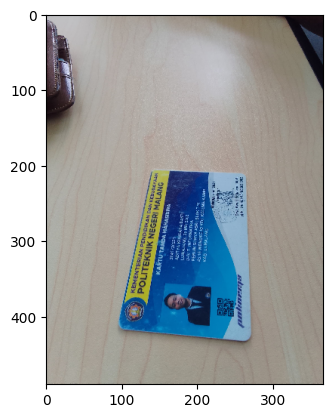

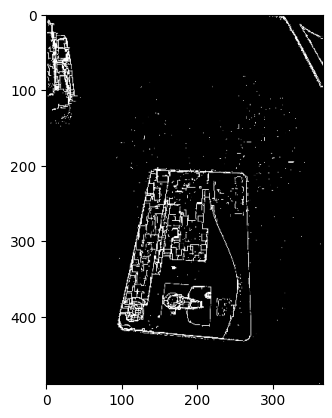

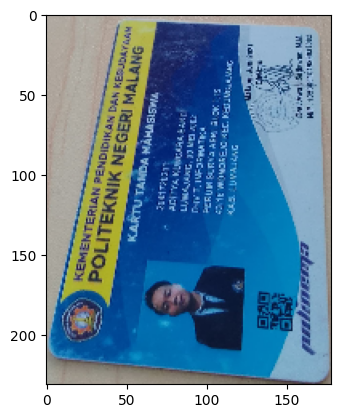

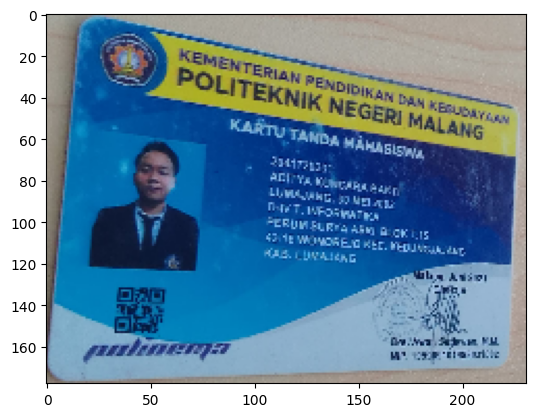

In [ ]:
ktm10 = cv2.imread(path_aditya[4])
ktm10_preprocess = preprocess_image(ktm10)
x, y, w, h = find_contours(ktm10_preprocess)
ktm_crop10 = ktm10[y:y+h,x:x+w]
ktm_rotated10 = cv2.rotate(ktm_crop10,cv2.ROTATE_90_CLOCKWISE)
ktm_aditya.append(ktm_rotated10)

display(ktm10)
display(ktm10_preprocess)
display(ktm_crop10)
display(ktm_rotated10)

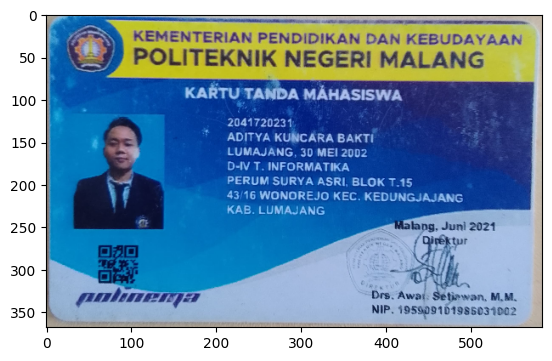

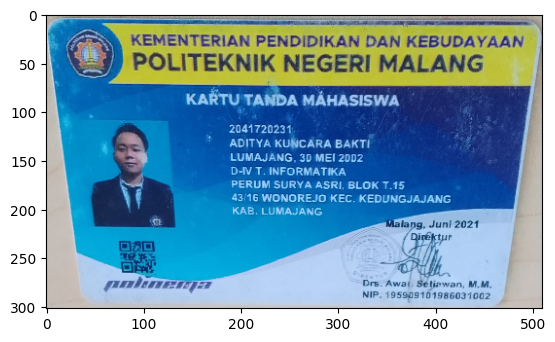

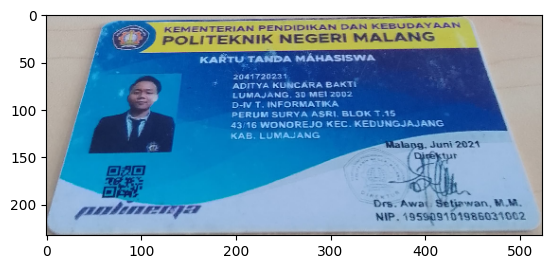

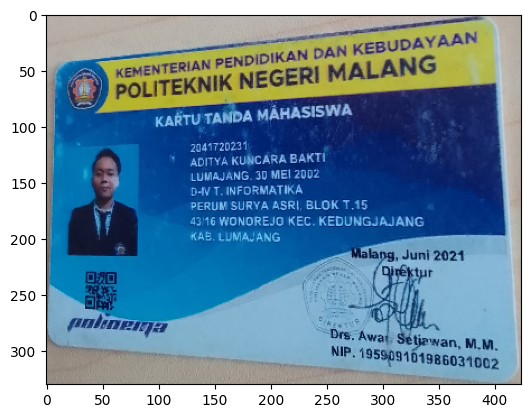

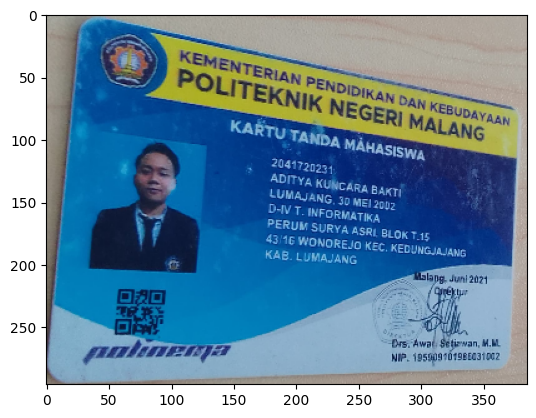

In [ ]:
# checking ktm_aditya[] values:
count = 0
for img in ktm_aditya:
  display2(img)
  count += 1

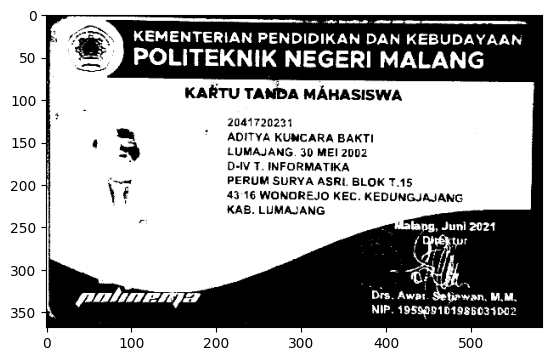

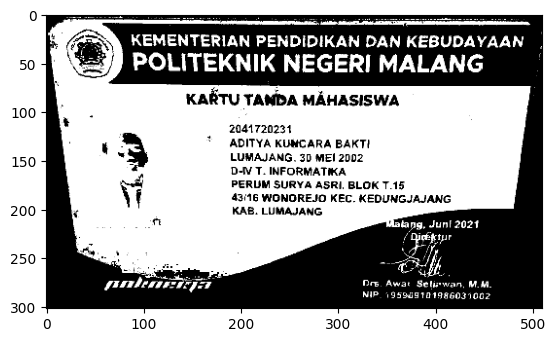

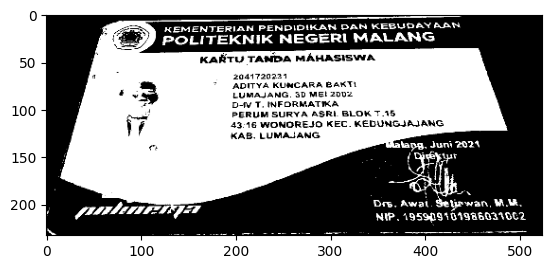

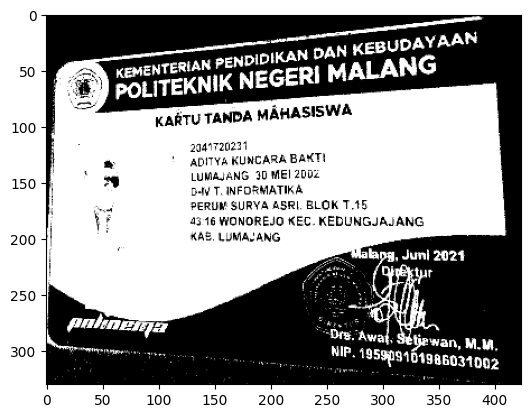

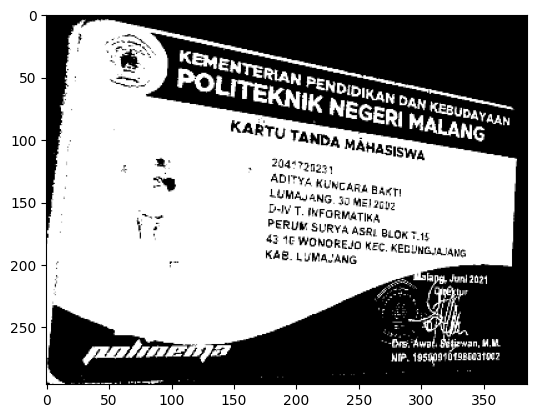

In [ ]:
# convert ktm_aditya[] to inverse
count = 0
for img in ktm_aditya:
  gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
  _, thresh = cv2.threshold(gray, 127, 255, cv2.THRESH_BINARY_INV)
  ktm_aditya_inversed.append(thresh)
  count += 1

# checking ktm_aditya_inversed[] values:
count = 0
for img in ktm_aditya_inversed:
  display2(img)
  count += 1

## Char Detection

- KTM 1

1/1 [==============================] - 0s 19ms/step


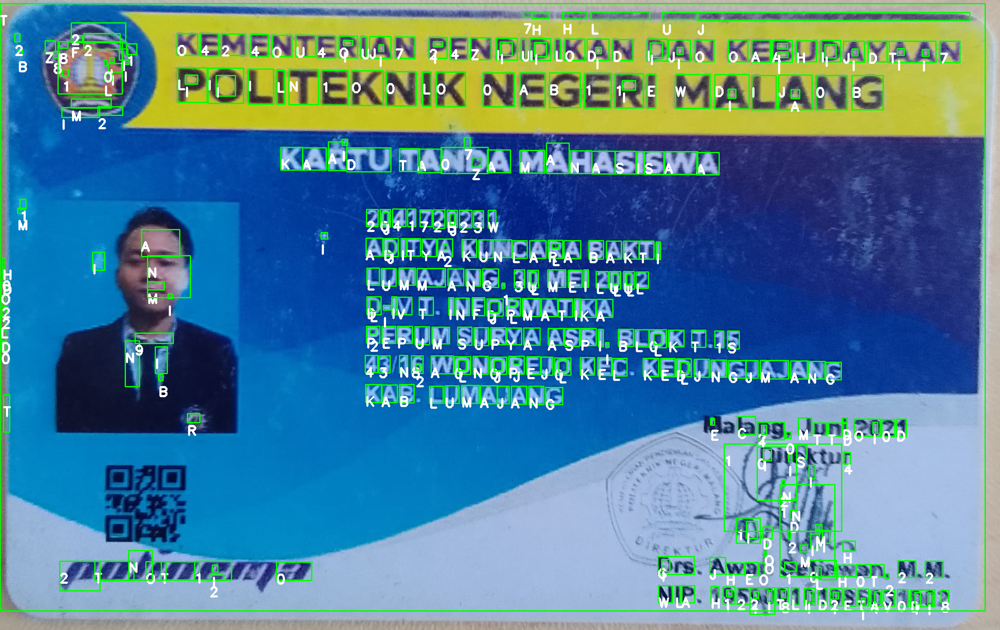

In [ ]:
ktm6_predict = predict(ktm_aditya[0], ktm_aditya_inversed[0], width, height, model, labels)
cv2_imshow(ktm6_predict)

- KTM 2

1/1 [==============================] - 0s 20ms/step


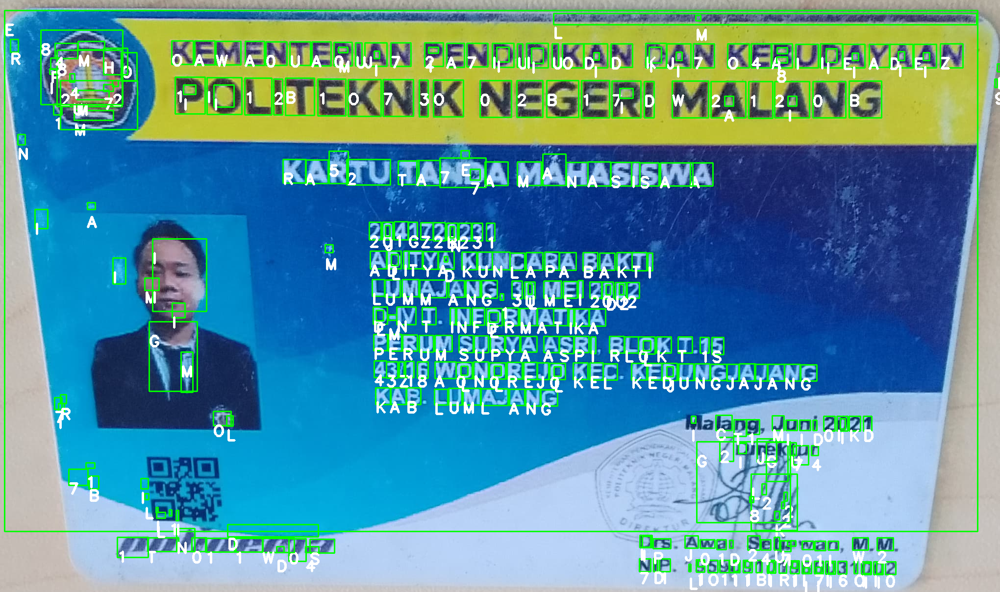

In [ ]:
ktm7_predict = predict(ktm_aditya[1], ktm_aditya_inversed[1], width, height, model, labels)
cv2_imshow(ktm7_predict)

- KTM 3

1/1 [==============================] - 0s 18ms/step


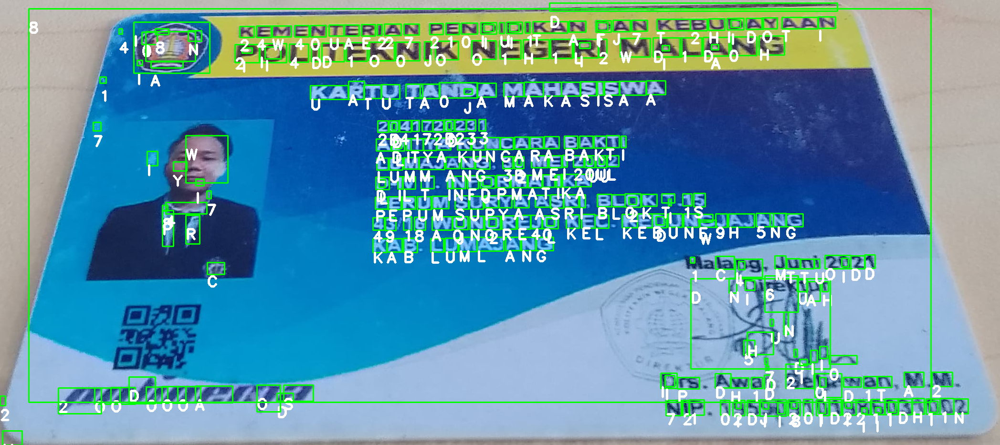

In [ ]:
ktm8_predict = predict(ktm_aditya[2], ktm_aditya_inversed[2], width, height, model, labels)
cv2_imshow(ktm8_predict)

- KTM 4

1/1 [==============================] - 0s 21ms/step


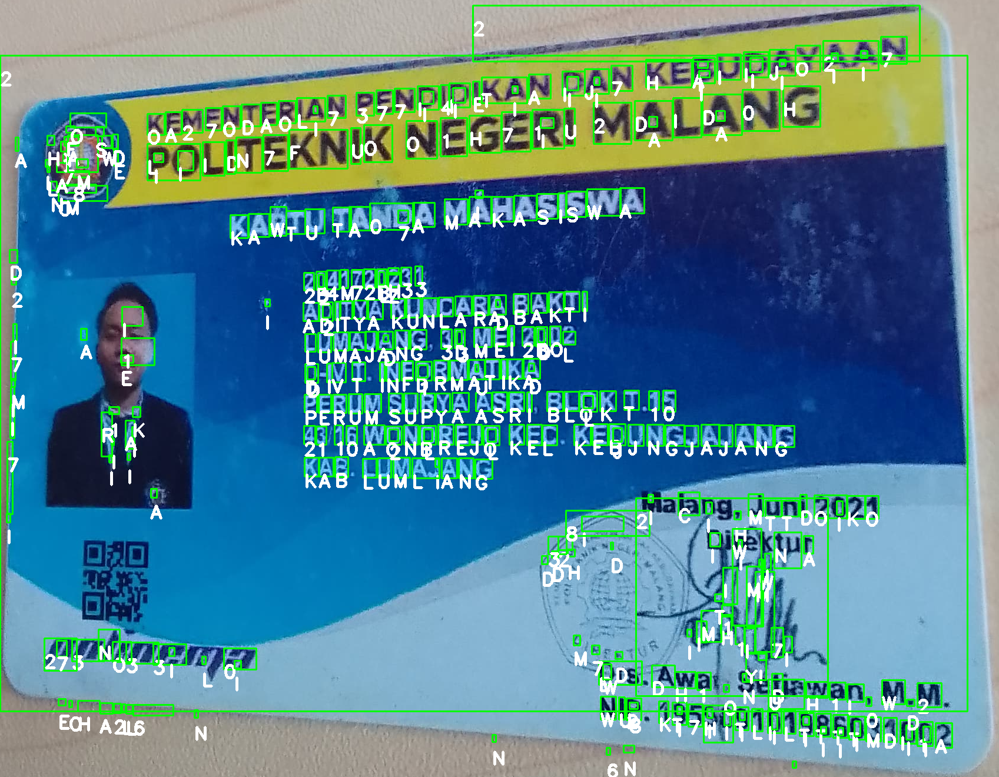

In [ ]:
ktm9_predict = predict(ktm_aditya[3], ktm_aditya_inversed[3], width, height, model, labels)
cv2_imshow(ktm9_predict)

- KTM 5

1/1 [==============================] - 0s 19ms/step


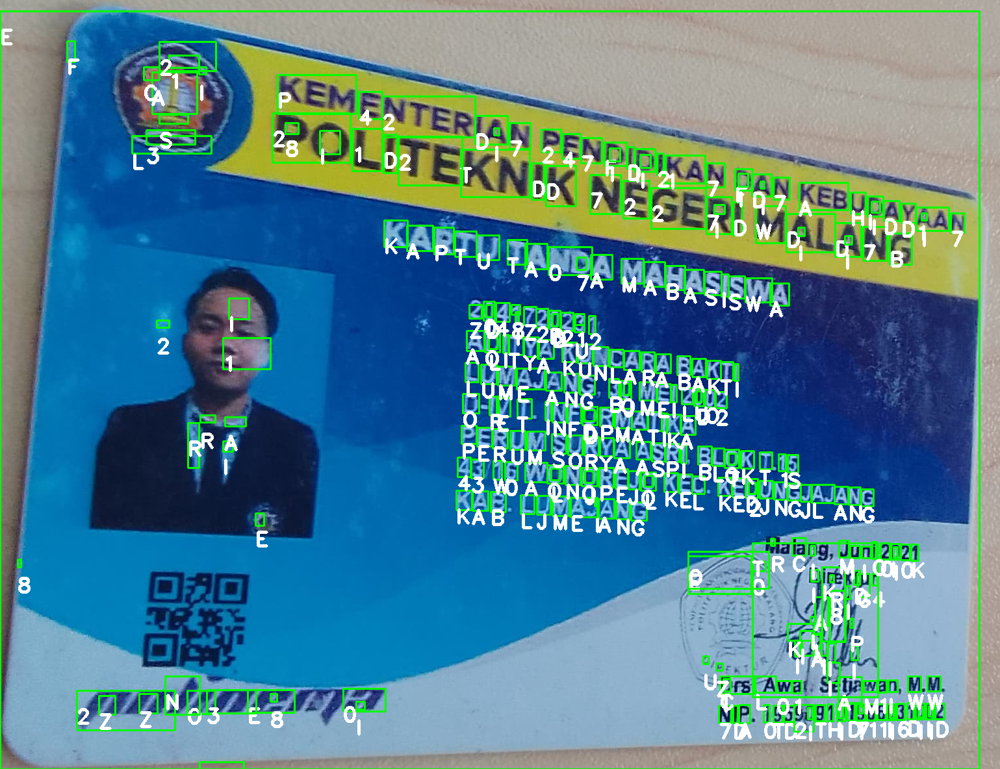

In [ ]:
ktm10_predict = predict(ktm_aditya[4], ktm_aditya_inversed[4], width, height, model, labels)
cv2_imshow(ktm10_predict)

# KTM Dandy

In [ ]:
ktm_dandy = []
ktm_dandy_preps = []

## Preprocessing

- KTM 1

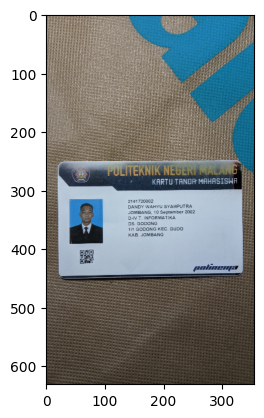

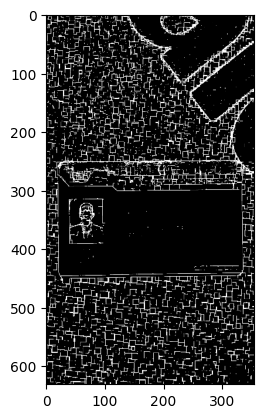

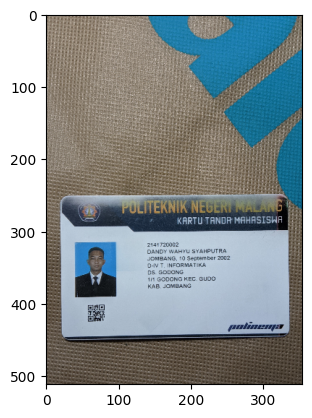

In [ ]:
ktm11 = cv2.imread(path_dandy[0])
ktm11_preprocess = preprocess_image(ktm11)
x, y, w, h = find_contours(ktm11_preprocess)
ktm_crop11 = ktm11[y:y+h,x:x+w]
ktm_dandy.append(ktm_crop11)

display(ktm11)
display(ktm11_preprocess)
display(ktm_crop11)

- KTM 2

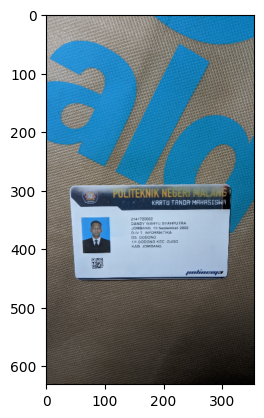

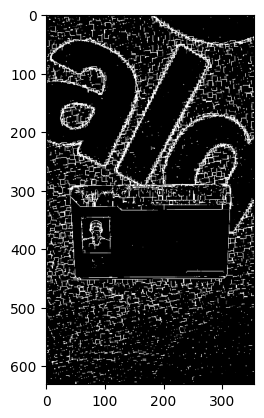

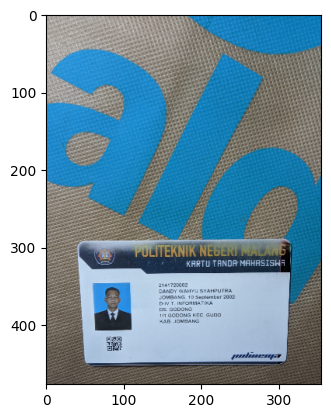

In [ ]:
ktm12 = cv2.imread(path_dandy[1])
ktm12_preprocess = preprocess_image(ktm12)
x, y, w, h = find_contours(ktm12_preprocess)
ktm_crop12 = ktm12[y:y+h,x:x+w]
ktm_dandy.append(ktm_crop12)

display(ktm12)
display(ktm12_preprocess)
display(ktm_crop12)

- KTM 3

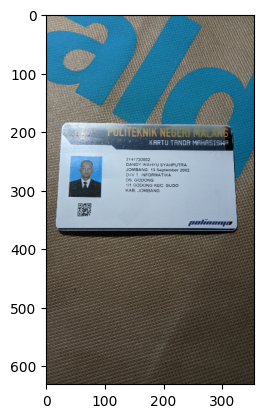

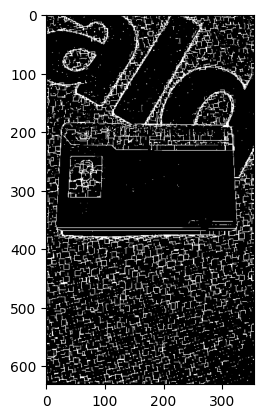

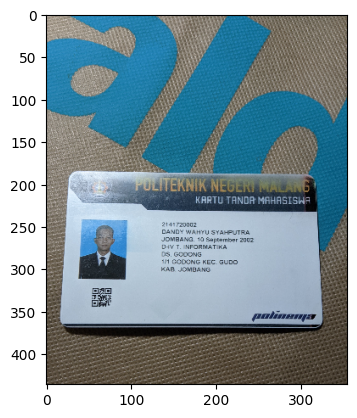

In [ ]:
ktm13 = cv2.imread(path_dandy[2])
ktm13_preprocess = preprocess_image(ktm13)
x, y, w, h = find_contours(ktm13_preprocess)
ktm_crop13 = ktm13[y:y+h,x:x+w]
ktm_dandy.append(ktm_crop13)

display(ktm13)
display(ktm13_preprocess)
display(ktm_crop13)

- KTM 4

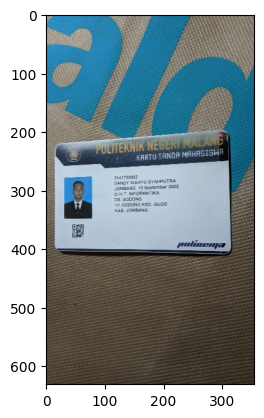

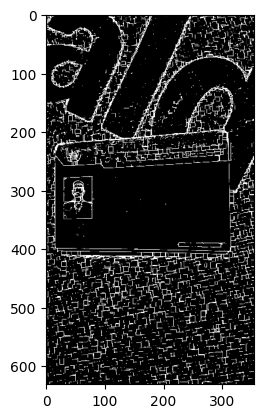

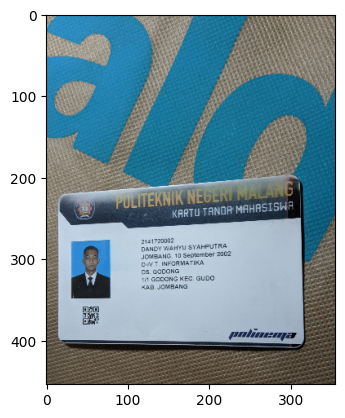

In [ ]:
ktm14 = cv2.imread(path_dandy[3])
ktm14_preprocess = preprocess_image(ktm14)
x, y, w, h = find_contours(ktm14_preprocess)
ktm_crop14 = ktm14[y:y+h,x:x+w]
ktm_dandy.append(ktm_crop14)

display(ktm14)
display(ktm14_preprocess)
display(ktm_crop14)

- KTM 5

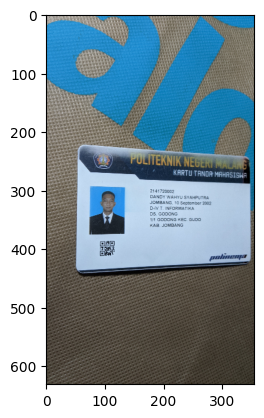

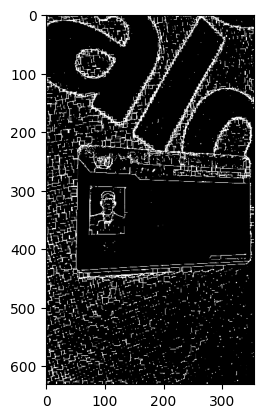

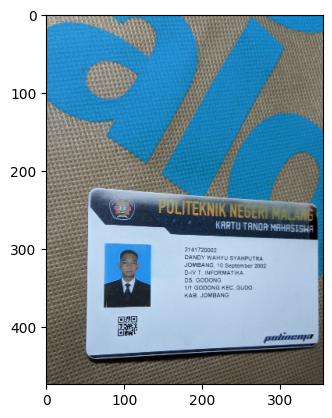

In [ ]:
ktm15 = cv2.imread(path_dandy[4])
ktm15_preprocess = preprocess_image(ktm15)
x, y, w, h = find_contours(ktm15_preprocess)
ktm_crop15 = ktm15[y:y+h,x:x+w]
ktm_dandy.append(ktm_crop15)

display(ktm15)
display(ktm15_preprocess)
display(ktm_crop15)

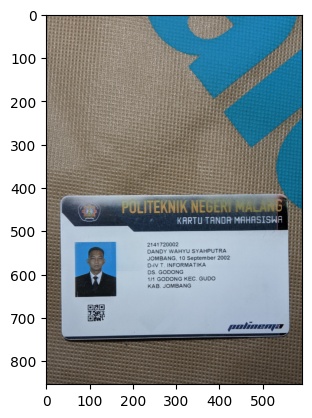

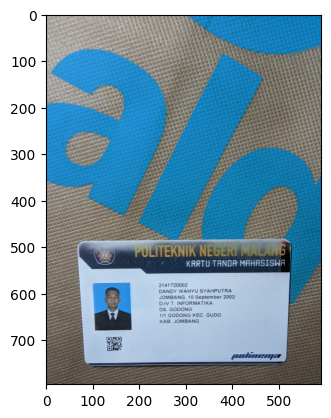

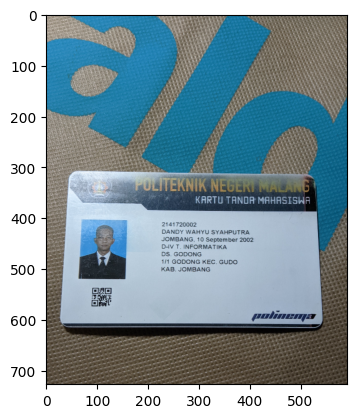

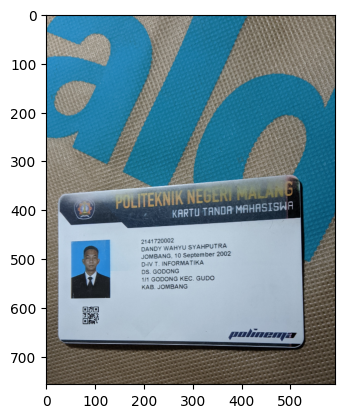

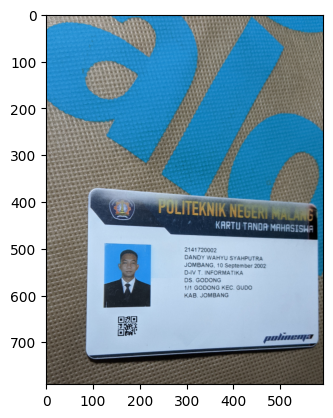

In [ ]:
# checking ktm_dandy[] values:
count = 0
for img in ktm_dandy:
  display2(img)
  count += 1

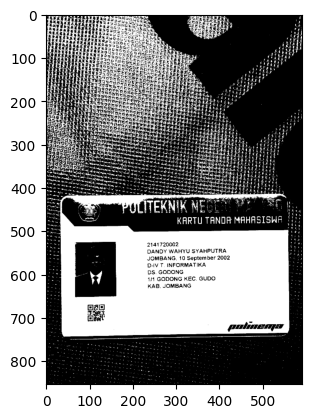

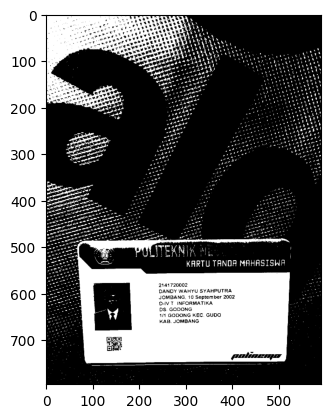

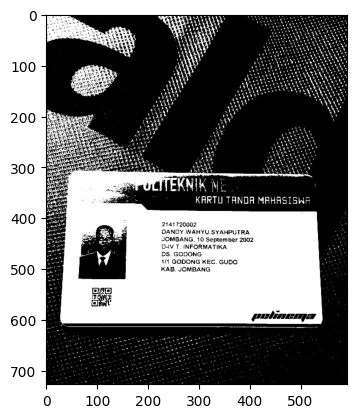

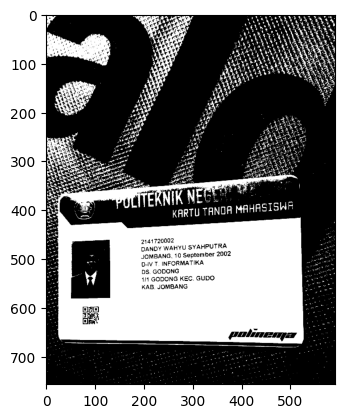

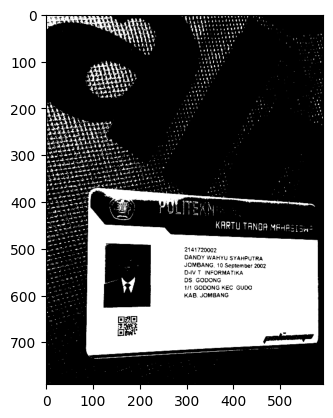

In [ ]:
# convert ktm_dandy[] to gray and thresh
count = 0
for img in ktm_dandy:
  gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
  _, thresh = cv2.threshold(gray, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
  ktm_dandy_preps.append(thresh)
  count += 1

# checking ktm_dandy_preps[] values:
count = 0
for img in ktm_dandy_preps:
  display2(img)
  count += 1

## Char Detection

- KTM 1

In [ ]:
ktm11_predict = predict(ktm_dandy[0], ktm_dandy_preps[0], width, height, model, labels)
cv2_imshow(ktm11_predict)

- KTM 2

In [ ]:
ktm12_predict = predict(ktm_dandy[1], ktm_dandy_preps[1], width, height, model, labels)
cv2_imshow(ktm12_predict)

- KTM 3

In [ ]:
ktm13_predict = predict(ktm_dandy[2], ktm_dandy_preps[2], width, height, model, labels)
cv2_imshow(ktm13_predict)

- KTM 4

In [ ]:
ktm14_predict = predict(ktm_dandy[3], ktm_dandy_preps[3], width, height, model, labels)
cv2_imshow(ktm14_predict)

- KTM 5

In [ ]:
ktm15_predict = predict(ktm_dandy[4], ktm_dandy_preps[4], width, height, model, labels)
cv2_imshow(ktm15_predict)